<a href="https://colab.research.google.com/github/DaraSamii/Mine-Problem-Competition/blob/main/Q1%26Q2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Initalization

## Login

In [3]:
from google.colab import drive

drive.mount('/content/drive')

%cd /content/drive/MyDrive/queraBox

pwd = %pwd

KeyboardInterrupt: ignored

## downloading data

In [ ]:
! gdown --id 1eU2TVE3cc4N_MYq53RrNkrj1ARm1EJHB

Downloading...
From: https://drive.google.com/uc?id=1eU2TVE3cc4N_MYq53RrNkrj1ARm1EJHB
To: /content/drive/My Drive/queraBox/data.zip
1.45GB [00:17, 82.9MB/s]


## Unziping Data

In [ ]:
! unzip data.zip 

## Upgrading FastAI

In [ ]:
!wget https://raw.githubusercontent.com/airctic/icevision/master/install_colab.sh
!bash install_colab.sh
!pip install -Uqq fastai

--2021-08-24 08:44:05--  https://raw.githubusercontent.com/airctic/icevision/master/install_colab.sh
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1244 (1.2K) [text/plain]
Saving to: ‘install_colab.sh’

install_colab.sh    100%[===================>]   1.21K  --.-KB/s    in 0s      

2021-08-24 08:44:06 (66.1 MB/s) - ‘install_colab.sh’ saved [1244/1244]

Installing icevision + dependencices for CUDA 10
Uninstalling some dependencies to prevent errors
Found existing installation: torchvision 0.10.0+cu102
Uninstalling torchvision-0.10.0+cu102:
  Successfully uninstalled torchvision-0.10.0+cu102
Found existing installation: fastai 1.0.61
Uninstalling fastai-1.0.61:
  Successfully uninstalled fastai-1.0.61
Installing some dependencies to prevent errors
     |██

## Imports

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import json
from fastai.vision.all import *
from icevision.all import *
import torch as T
import PIL

INFO     - Downloading default `.ttf` font file - SpaceGrotesk-Medium.ttf from https://raw.githubusercontent.com/airctic/storage/master/SpaceGrotesk-Medium.ttf to /root/.icevision/fonts/SpaceGrotesk-Medium.ttf | icevision.visualize.utils:get_default_font:69
INFO     - Downloading mmdet configs | icevision.models.mmdet.download_configs:download_mmdet_configs:31


0B [00:00, ?B/s]

## setting data paths

In [5]:
train_folder = os.path.join(pwd, "train")
test_folder = os.path.join(pwd, "test-rqd")
labels = pd.read_excel("label.xlsx")
fromto = pd.read_excel("from-to-rqd.xlsx")

# Question 1

## Part 1
finding `count` of images in `train folder`

In [ ]:
list_images = os.listdir(train_folder)
len(list_images)

156

## Part 2
finding unique number of "Gone"

In [ ]:
slpited_list = list(map(lambda x: x.split("-"),list_images))

In [ ]:
ziped = list(zip(*slpited_list))

In [ ]:
len(set(ziped[1]))

5

## Part 3
finding `longest` Run

In [ ]:
fromto["Len"] = ndf["Len"] = ndf.apply(lambda x: x["to"] - x["from"],axis=1).apply(lambda x: x["to"] - x["from"],axis=1)

,RunId,from,to
0,M3-BH3299-1-1,0.00,2.20
1,M3-BH3299-1-2,2.20,3.30
2,M3-BH3299-1-3,3.30,4.40
3,M3-BH3299-2-1,4.40,4.90
4,M3-BH3299-2-2,4.90,6.50
...,...,...,...
175,M3-BH3301-20-1,89.85,90.00
176,M3-BH3301-20-2,90.00,90.90
177,M3-BH3301-20-3,90.90,92.60
178,M3-BH3301-20-4,92.60,94.70


## Part 4
finding deepest RunID

In [ ]:
a = list(fromto[fromto["to"] == fromto["to"].max()]["RunId"])
b= a[0]
"-".join(b.split("-")[0:2])

'M3-BH3301'

# Question 2

## corecting box bounderies

In [6]:
labels

,image_name,label_name,xmin,ymin,width,height,image_width,image_height
0,M3-BH130-1.jpg,wood,2412,1552,152,197,4020,2929
1,M3-BH130-1.jpg,wood,2917,2072,140,220,4020,2929
2,M3-BH130-1.jpg,wood,3820,1567,167,209,4020,2929
3,M3-BH130-1.jpg,wood,3603,2341,201,186,4020,2929
4,M3-BH130-1.jpg,wood,1676,2713,159,171,4020,2929
...,...,...,...,...,...,...,...,...
2358,M3-BH13400-7.JPG,+10cm rock,267,1851,404,209,4084,3426
2359,M3-BH13400-7.JPG,wood,1217,1828,200,249,4084,3426
2360,M3-BH13400-7.JPG,wood,733,2148,235,266,4084,3426
2361,M3-BH13250-26.jpg,+10cm rock,308,1671,240,118,3223,2407


## image dateloader

In [7]:
imgs = os.listdir(train_folder)

## COCO Style dateset making

In [6]:
img2bbox = {}
for img in imgs:
    a = labels[labels["image_name"] == img]
    xmin = list(a["xmin"])
    ymin = list(a["ymin"])
    wid = list(a["width"])
    hei = list(a["height"])

    width = set(a["image_width"])
    height = set(a["image_height"])

    label_name = list(a["label_name"])

    img2bbox[img] = (list(map(lambda x: list(x),list(zip(xmin, ymin, wid, hei)))),
                     label_name,
                     width,
                     height)


In [7]:
categories = {
    "+10cm rock":1,
    "wood":2
}

In [8]:
coco_categori =[
                {"id":1,
                 "name":"+10cm rock",
                 "suppercategory":"all"},
                {"id":2,
                 "name": "wood",
                 "suppercategory":"all"}
]

In [ ]:
images = []
annotations = []

for i in range(len(img2bbox.keys())):
    key = list(img2bbox.keys())[i]

    images.append(
        {"id": i,
         "file_name": key,
         "width": list(img2bbox[key][2])[0],
         "heigth":list(img2bbox[key][3])[0],
         
        }
    )
    for j in range(len(img2bbox[key][0])):
        annotations.append(
            {"id":i*100 + j,
            "image_id":i,
            "category_id":categories[img2bbox[key][1][j]],
            "bbox": img2bbox[key][0][j],
             "iscrowd":0,
             "area": img2bbox[key][0][j][2] * img2bbox[key][0][j][3]
            }
        )


In [ ]:
annotations[0]

{'area': 54570,
 'bbox': [70, 1573, 321, 170],
 'category_id': 1,
 'id': 0,
 'image_id': 0,
 'iscrowd': 0}

In [ ]:
coco_dict ={
    "categories":coco_categori,
    "images":images,
    "annotations":annotations,
    "info": {"year":2021,
             "version":1,
             "description":"None",
            },
    "licenses":{"id":1,
                "name":"free",
                "url":""}
}

In [ ]:
coco_dict

### savig the file

In [ ]:
with open('data.json', 'w') as f:
    json.dump(coco_dict, f)

## creating object detection model

### creating train and valid datasets

In [8]:
parser = parsers.COCOBBoxParser(os.path.join(pwd,"data.json"),train_folder)

In [9]:
class_map = parser.class_map
class_map

<ClassMap: {'background': 0, '+10cm rock': 1, 'wood': 2}>

In [10]:
parser.img_dir

Path('/content/drive/MyDrive/queraBox/train')

In [11]:
train_records, valid_records = parser.parse()

  0%|          | 0/2363 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:136


  0%|          | 0/124 [00:00<?, ?it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

In [12]:
# Transforms
# size is set to 384 because EfficientDet requires its inputs to be divisible by 128
image_size = 512
train_tfms = tfms.A.Adapter([*tfms.A.aug_tfms(size=image_size, presize=512,shift_scale_rotate=None,), tfms.A.Normalize()])
valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(image_size), tfms.A.Normalize()])

In [13]:
train_ds = Dataset(train_records, train_tfms)
valid_ds = Dataset(valid_records, valid_tfms)

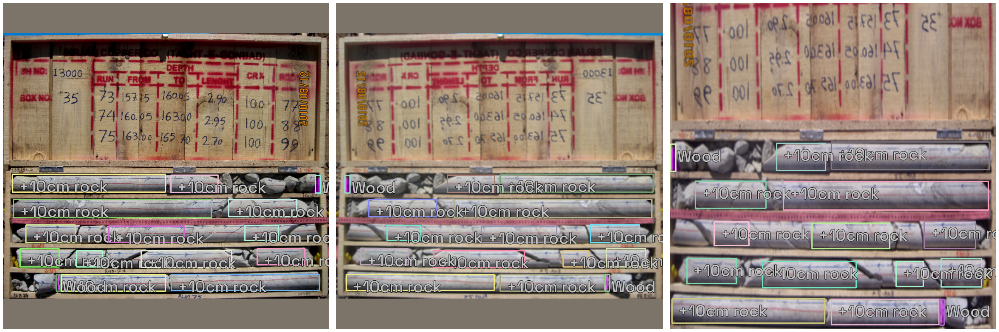

In [164]:
samples = [train_ds[0] for _ in range(3)]
show_samples(samples, ncols=3)

### creating model

In [45]:
model_type = models.mmdet.retinanet
backbone = model_type.backbones.resnet101_fpn_1x(pretrained=True)

In [46]:
# Instantiate the mdoel
model = model_type.model(backbone=backbone, num_classes=len(parser.class_map)) 

  0%|          | 0/228377232 [00:00<?, ?B/s]

/usr/local/lib/python3.7/dist-packages/mmcv/cnn/utils/weight_init.py:119: UserWarning: init_cfg without layer key, if you do not define override key either, this init_cfg will do nothing
  'init_cfg without layer key, if you do not define override'


Use load_from_local loader
The model and loaded state dict do not match exactly

size mismatch for bbox_head.retina_cls.weight: copying a param with shape torch.Size([720, 256, 3, 3]) from checkpoint, the shape in current model is torch.Size([18, 256, 3, 3]).
size mismatch for bbox_head.retina_cls.bias: copying a param with shape torch.Size([720]) from checkpoint, the shape in current model is torch.Size([18]).


### loading pretrained model
needs to fix the named dict to fit

In [16]:
state_dict = T.load(os.path.join(pwd,"models","efficient.pth"),map_location=T.device('cuda'))

for key in list(state_dict.keys()):
    state_dict[key.replace("model.", "")] = state_dict.pop(key)

model.load_state_dict(state_dict)

<All keys matched successfully>

In [17]:
model = model.cuda()

In [18]:
# Data Loaders
train_dl = model_type.train_dl(train_ds, batch_size=8, num_workers=2, shuffle=True)
valid_dl = model_type.valid_dl(valid_ds, batch_size=8, num_workers=2, shuffle=False)

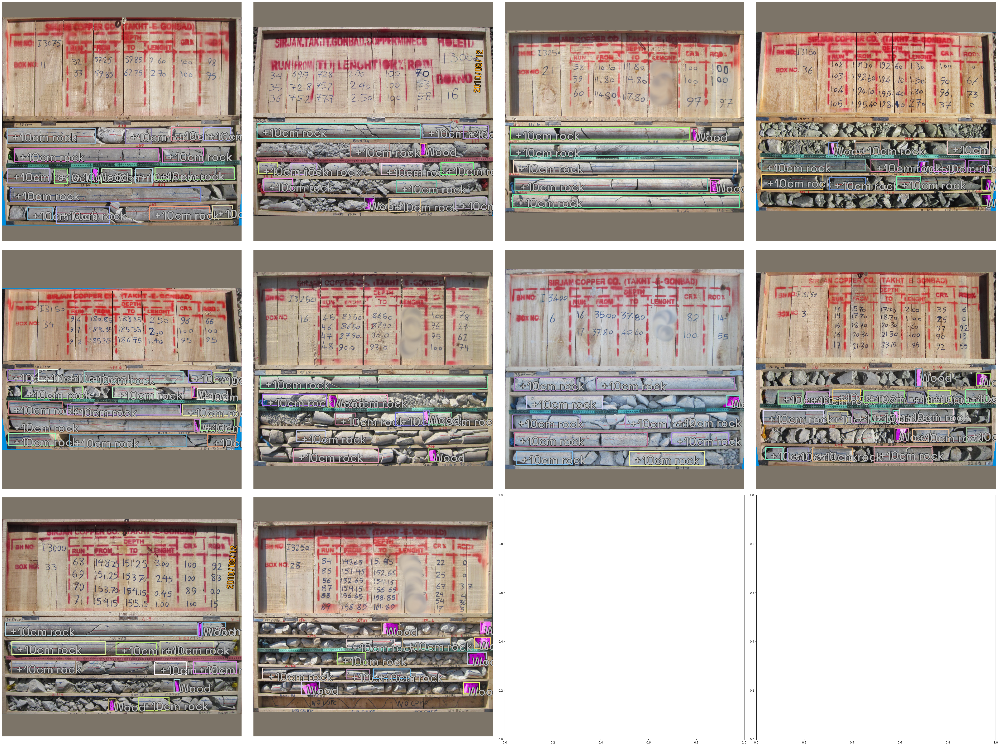

In [170]:
model_type.show_batch(first(valid_dl), ncols=4)

### creating learner

In [47]:
metrics = [COCOMetric(metric_type=COCOMetricType.bbox)]

In [48]:
learn = model_type.fastai.learner(dls=[train_dl, valid_dl], model=model,metrics=metrics)

In [49]:
grp = ShowGraphCallback
svm = SaveModelCallback(at_end=False,every_epoch=False,reset_on_fit=False,fname="efficient101",monitor="COCOMetric")
esc = EarlyStoppingCallback(patience=3)
rlr = ReduceLROnPlateau(monitor="valid_loss",patience=1,factor=10,)
learn.add_cbs([grp,svm,esc,rlr])
learn.cbs

(#8) [TrainEvalCallback,Recorder,ProgressCallback,BBoxMMDetectionCallback,ShowGraphCallback,SaveModelCallback,EarlyStoppingCallback,ReduceLROnPlateau]

### fine tune model

epoch,train_loss,valid_loss,COCOMetric,time
0,1.321052,1.315269,0.001544,01:31
1,1.099180,1.028952,0.028922,00:59
2,0.955321,0.901435,0.112123,00:56
3,0.852839,0.830895,0.177448,00:55
4,0.779397,0.780645,0.209953,00:57
5,0.714836,0.758185,0.250185,00:56
6,0.661810,0.703072,0.259141,00:56
7,0.625272,0.791244,0.264006,00:56
8,0.603167,0.703644,0.307000,00:56
9,0.582771,0.692818,0.281545,00:56


Better model found at epoch 0 with COCOMetric value: 0.0015435536049487758.


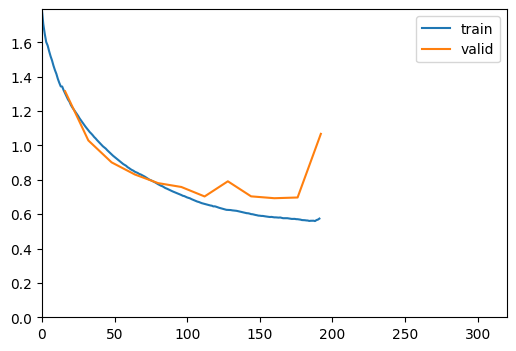

Better model found at epoch 1 with COCOMetric value: 0.028922314528911284.
Better model found at epoch 2 with COCOMetric value: 0.11212287528223332.
Better model found at epoch 3 with COCOMetric value: 0.17744750986770744.
Better model found at epoch 4 with COCOMetric value: 0.20995310491039507.
Better model found at epoch 5 with COCOMetric value: 0.2501845097966197.
Better model found at epoch 6 with COCOMetric value: 0.25914127205327464.
Better model found at epoch 7 with COCOMetric value: 0.2640060979222204.
Epoch 7: reducing lr to 3.72939956851198e-05
Better model found at epoch 8 with COCOMetric value: 0.30700042254821824.
Epoch 8: reducing lr to 4.4698078449946224e-05
Epoch 10: reducing lr to 5.986594146088336e-05
Epoch 11: reducing lr to 6.724867568024106e-05
Epoch 12: reducing lr to 7.42483373660391e-05
No improvement since epoch 9: early stopping


epoch,train_loss,valid_loss,COCOMetric,time
0,0.520438,0.737317,0.312024,00:56
1,0.495602,0.656238,0.324797,00:56
2,0.486679,0.854342,0.320341,00:56
3,0.487832,0.663991,0.341694,00:56
4,0.486862,0.660519,0.348584,00:57


Better model found at epoch 0 with COCOMetric value: 0.312024138847951.


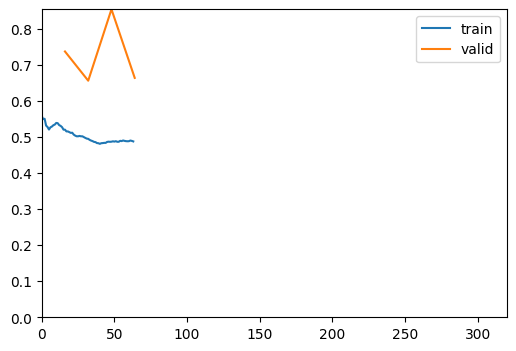

Better model found at epoch 1 with COCOMetric value: 0.32479738070008246.
Epoch 2: reducing lr to 2.934561522434356e-05
Better model found at epoch 3 with COCOMetric value: 0.34169369669178734.
Epoch 3: reducing lr to 3.942793473651997e-05
Better model found at epoch 4 with COCOMetric value: 0.3485838651901349.
Epoch 4: reducing lr to 4.698404231209733e-05
No improvement since epoch 1: early stopping


epoch,train_loss,valid_loss,COCOMetric,time
0,0.460382,0.633562,0.359290,00:55
1,0.447473,0.620932,0.364979,00:55
2,0.437448,0.612828,0.367949,00:55
3,0.427439,0.601085,0.378845,00:56
4,0.420782,0.593293,0.377165,00:56
5,0.416896,0.585290,0.375916,00:56
6,0.412145,0.582551,0.375524,00:55
7,0.404712,0.578660,0.380861,00:55
8,0.402347,0.577052,0.385388,00:56
9,0.395640,0.589695,0.381223,00:55


Better model found at epoch 0 with COCOMetric value: 0.35928990070051076.


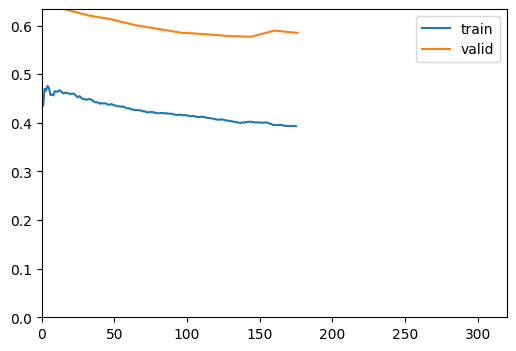

Better model found at epoch 1 with COCOMetric value: 0.3649794546283503.
Better model found at epoch 2 with COCOMetric value: 0.36794857162291583.
Better model found at epoch 3 with COCOMetric value: 0.3788450100169216.
Better model found at epoch 7 with COCOMetric value: 0.38086072910127694.
Better model found at epoch 8 with COCOMetric value: 0.38538758934805756.
Epoch 9: reducing lr to 5.2285597374636414e-06
Epoch 10: reducing lr to 5.9865941460883355e-06
Epoch 11: reducing lr to 6.724867568024105e-06
No improvement since epoch 8: early stopping


epoch,train_loss,valid_loss,COCOMetric,time
0,0.396272,0.570871,0.386414,00:56
1,0.386428,0.574615,0.384475,00:56
2,0.381261,0.580549,0.387643,00:55
3,0.381974,0.567355,0.391975,00:56
4,0.377816,0.580963,0.383443,00:57
5,0.376597,0.574694,0.393815,00:56
6,0.373204,0.575672,0.393365,00:57


Better model found at epoch 0 with COCOMetric value: 0.38641384560737935.


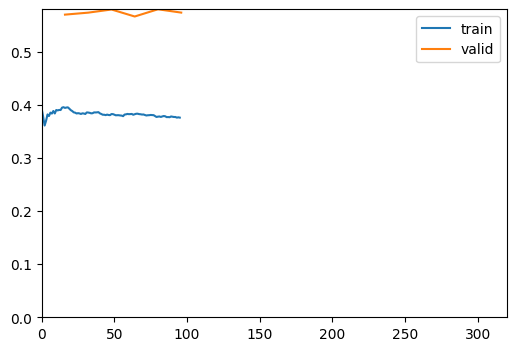

Epoch 1: reducing lr to 1.9438642456939008e-06
Better model found at epoch 2 with COCOMetric value: 0.3876433914801825.
Epoch 2: reducing lr to 2.9345615224343553e-06
Better model found at epoch 3 with COCOMetric value: 0.39197543890992104.
Epoch 4: reducing lr to 4.698404231209732e-06
Better model found at epoch 5 with COCOMetric value: 0.39381465389868653.
Epoch 5: reducing lr to 4.998929170868221e-06
Epoch 6: reducing lr to 4.944882495240157e-06
No improvement since epoch 3: early stopping


epoch,train_loss,valid_loss,COCOMetric,time
0,0.362191,0.573076,0.395107,00:55
1,0.362771,0.571460,0.395470,00:55
2,0.364426,0.569886,0.393984,00:56
3,0.362870,0.568642,0.393131,00:55
4,0.363035,0.567594,0.395670,00:55
5,0.364587,0.566882,0.395988,00:56


Better model found at epoch 0 with COCOMetric value: 0.3951066059861933.


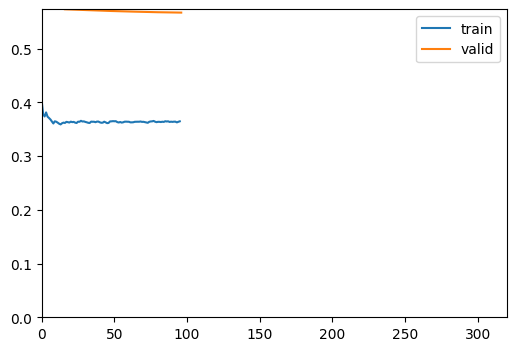

Better model found at epoch 1 with COCOMetric value: 0.3954695299684627.
Better model found at epoch 4 with COCOMetric value: 0.39566952648019516.
Better model found at epoch 5 with COCOMetric value: 0.39598761570306046.


epoch,train_loss,valid_loss,COCOMetric,time
0,0.362191,0.573076,0.395107,00:55
1,0.362771,0.571460,0.395470,00:55
2,0.364426,0.569886,0.393984,00:56
3,0.362870,0.568642,0.393131,00:55
4,0.363035,0.567594,0.395670,00:55
5,0.364587,0.566882,0.395988,00:56
6,0.362323,0.567293,0.395127,00:56
7,0.360153,0.566916,0.393546,00:55
8,0.358312,0.566442,0.390322,00:55
9,0.358025,0.565345,0.392619,00:55


Epoch 6: reducing lr to 3.0259368760348646e-07


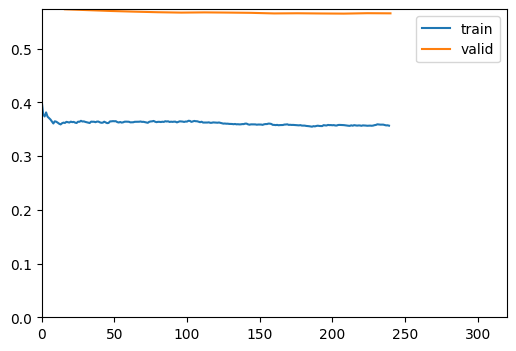

Epoch 7: reducing lr to 3.729399568511981e-07
Epoch 10: reducing lr to 5.986594146088337e-07
Better model found at epoch 11 with COCOMetric value: 0.3969917483345161.
Epoch 13: reducing lr to 8.068905582453834e-07
Epoch 14: reducing lr to 8.640904963949679e-07
Better model found at epoch 15 with COCOMetric value: 0.39744297521044136.
Epoch 15: reducing lr to 9.126461710625725e-07
No improvement since epoch 12: early stopping


epoch,train_loss,valid_loss,COCOMetric,time
0,0.360192,0.564468,0.397203,00:56
1,0.357545,0.564454,0.396817,00:56
2,0.355354,0.562363,0.394877,00:55
3,0.356676,0.563400,0.394075,00:56
4,0.355535,0.564303,0.393571,00:56
5,0.355129,0.564338,0.391366,00:55


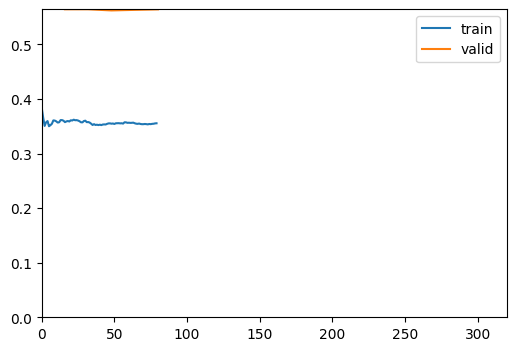

Epoch 3: reducing lr to 3.942793473651997e-07
Epoch 4: reducing lr to 4.698404231209733e-07
Epoch 5: reducing lr to 4.99892917086822e-07
No improvement since epoch 2: early stopping


In [50]:
learn.fine_tune(20, 1e-3, freeze_epochs=20)
learn.fine_tune(20, 1e-4, freeze_epochs=20)
learn.fine_tune(20, 1e-5, freeze_epochs=20)

In [ ]:
learn.fine_tune(0, 5e-4, freeze_epochs=3)

In [199]:
T.cuda.empty_cache()

## see the results

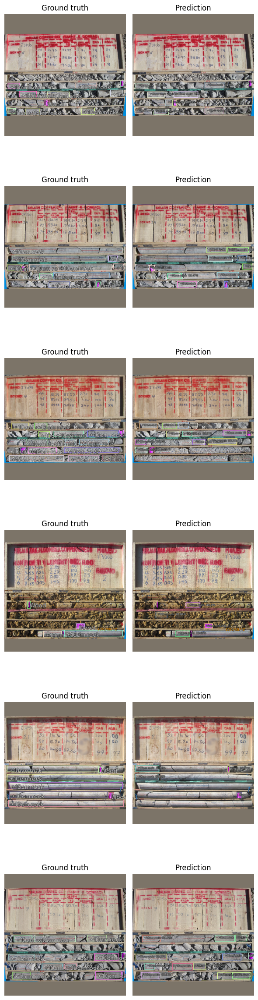

In [51]:
model_type.show_results(model, valid_ds, detection_threshold=0.46,)

In [19]:
test_imgs_files = os.listdir(test_folder)
len(test_imgs_files)

48

In [20]:
test_imgs_files[0]

'M3-BH3301-21.jpg'

In [21]:
test_imgs = list(map(lambda x: PIL.Image.open(os.path.join(test_folder,x)), test_imgs_files))

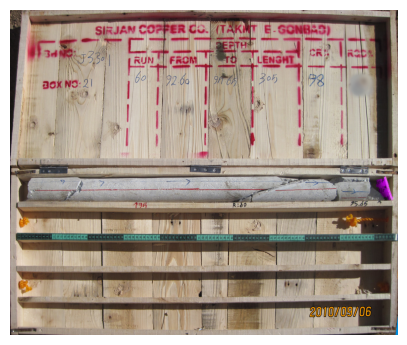

In [26]:
show_image(test_imgs[0])

## Tests

In [52]:
infer_ds = Dataset.from_images(test_imgs, valid_tfms,class_map=class_map)
infer_dl  = model_type.infer_dl(infer_ds,shuffle=False)

In [55]:
preds = model_type.predict_from_dl(model=model, infer_dl=infer_dl, keep_images=True,detection_threshold=.3)

  0%|          | 0/48 [00:00<?, ?it/s]

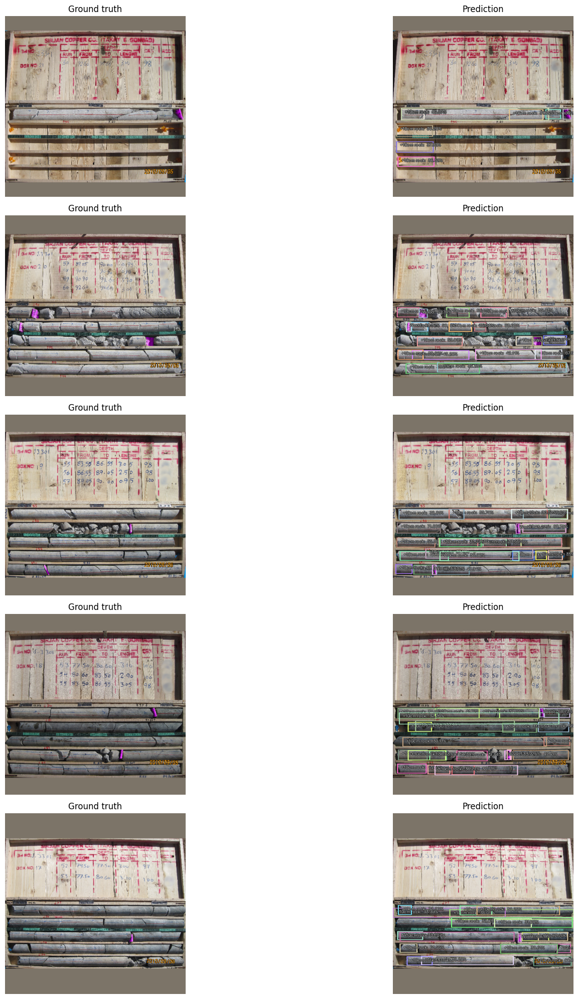

In [56]:
show_preds(preds[0:5],figsize=(20,20))

In [ ]:
img = test_imgs_files[1]
img

'M3-BH3301-20.jpg'

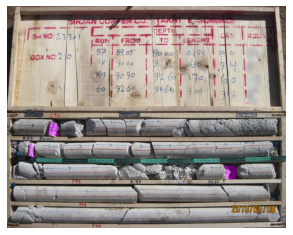

In [ ]:
show_image(PIL.Image.open(os.path.join(test_folder,img)))

In [57]:
fromto["Run"] = fromto["RunId"].apply(lambda x: "-".join(x.split("-")[:-1]))
fromto["part"] = fromto["RunId"].apply(lambda x: x.split("-")[-1])
fromto["lenght"] = fromto["to"] - fromto["from"]

In [58]:
fromto

,RunId,from,to,Run,part,lenght
0,M3-BH3299-1-1,0.00,2.20,M3-BH3299-1,1,2.20
1,M3-BH3299-1-2,2.20,3.30,M3-BH3299-1,2,1.10
2,M3-BH3299-1-3,3.30,4.40,M3-BH3299-1,3,1.10
3,M3-BH3299-2-1,4.40,4.90,M3-BH3299-2,1,0.50
4,M3-BH3299-2-2,4.90,6.50,M3-BH3299-2,2,1.60
...,...,...,...,...,...,...
175,M3-BH3301-20-1,89.85,90.00,M3-BH3301-20,1,0.15
176,M3-BH3301-20-2,90.00,90.90,M3-BH3301-20,2,0.90
177,M3-BH3301-20-3,90.90,92.60,M3-BH3301-20,3,1.70
178,M3-BH3301-20-4,92.60,94.70,M3-BH3301-20,4,2.10


In [59]:
results = []
for i in range(len(test_imgs_files)):
    result = {}
    result["image_name"] = test_imgs_files[i]
    compos = preds[i].pred.detection
    lables = getattr(compos, "labels", [])
    bboxes = getattr(compos, "bboxes", [])
    scores = getattr(compos, "scores", [])
    qwe = []
    for i in range(len(bboxes)):
        a = {}
        a["label"] = lables[i]
        a["xmin"] = bboxes[i].xmin
        a["ymin"] = bboxes[i].ymin
        a["xmax"] = bboxes[i].xmax
        a["ymax"] = bboxes[i].ymax
        a["pixel"] = np.sqrt(a["xmin"]**2 + a["ymin"]**2) + a["xmin"]
        a["width_pixed"] = bboxes[i].xmax - bboxes[i].xmin
        a["real_width"] = (bboxes[i].xmax - bboxes[i].xmin)/image_size * 1.1
        a["score"] = scores[i]
        qwe.append(a)
    
    qwe.sort(key=lambda x:x["pixel"])
    result["detected"] = qwe
    results.append(result)

In [ ]:
results[1]

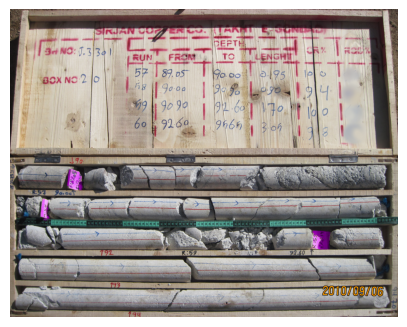

In [39]:
show_image(PIL.Image.open(os.path.join(test_folder,results[1]["image_name"])))

In [60]:
def isRectangleOverlap(self, R1, R2):
    if (R1[0]>=R2[2]) or (R1[2]<=R2[0]) or (R1[3]<=R2[1]) or (R1[1]>=R2[3]):
        return False
    else:
        return True

In [69]:
rock_thresh = 0.4
wood_thresh = 0.35

In [70]:
output = []
z = 0
for result in results:
    count = 0
    SUM = 0.0
    pices = []
    pices_sum = []
    for p in result['detected']:
        boxes = []
        if p["label"] =="+10cm rock":
            if p["real_width"]>0.1:
                if p["score"] > rock_thresh:
                    boxes.append([p["xmin"],p["ymin"],p["xmax"],p["ymax"]])
                    if len(boxes) < 2:
                        count += 1
                        SUM += p["real_width"]
                    else:
                        if isRectangleOverlap(boxes[-2], boxes[-1]) == False:
                            count += 1
                            SUM += p["real_width"]
        
        elif p["label"] == "wood":
            if p['score'] > wood_thresh:
                pices.append(count)
                pices_sum.append(SUM)
                count = 0
                SUM = 0.0

    pices.append(count)
    pices_sum.append(SUM)  
    
    for i in range(len(pices)):
        OUT = {}
        OUT["RunId"] = result["image_name"].replace(".jpg","")+"-"+str(i+1)
        OUT["SUM+10"] = pices_sum[i] 
        try:
            OUT["lenght"] = fromto[fromto["RunId"] == OUT["RunId"]]["lenght"].values[0]
        except:
            OUT["lenght"] = 0.0
        output.append(OUT)
        

In [71]:
out_df = pd.DataFrame(output)
out_df

,RunId,SUM+10,lenght
0,M3-BH3301-21-1,1.034015,0.95
1,M3-BH3301-21-2,0.000000,0.00
2,M3-BH3301-20-1,0.129821,0.15
3,M3-BH3301-20-2,0.000000,0.90
4,M3-BH3301-20-3,1.308047,1.70
...,...,...,...
181,M3-BH3299-2-5,0.274584,0.70
182,M3-BH3299-2-6,0.358097,0.70
183,M3-BH3299-1-1,0.938348,2.20
184,M3-BH3299-1-2,0.000000,1.10


In [72]:
out_df = out_df[out_df["lenght"] != 0.0]
out_df['RQD'] = out_df.apply(lambda x: x["SUM+10"]/(x["lenght"]) * 100,axis=1)
out_df

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,RunId,SUM+10,lenght,RQD
0,M3-BH3301-21-1,1.034015,0.95,108.843720
2,M3-BH3301-20-1,0.129821,0.15,86.547174
3,M3-BH3301-20-2,0.000000,0.90,0.000000
4,M3-BH3301-20-3,1.308047,1.70,76.943957
5,M3-BH3301-20-4,0.298285,2.10,14.204025
...,...,...,...,...
181,M3-BH3299-2-5,0.274584,0.70,39.226219
182,M3-BH3299-2-6,0.358097,0.70,51.156764
183,M3-BH3299-1-1,0.938348,2.20,42.652173
184,M3-BH3299-1-2,0.000000,1.10,0.000000


In [73]:
def classifier(x):
    if 0<= x and x<= 25:
        return '1'
    elif 25 < x and x<=50:
        return '2'
    elif 50<x and x<= 75:
        return '3'
    elif 75 < x and x<=90:
        return '4'
    elif 90<x:
        return '5'

In [74]:
out_df["Prediction"] = out_df["RQD"].apply(lambda x: classifier(x))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [2]:
out_df.to_csv("report.csv",index=False)

NameError: ignored

In [75]:
last = out_df[["RunId","Prediction"]]
last = last.fillna(1.0)
last.head(30)

,RunId,Prediction
0,M3-BH3301-21-1,5
2,M3-BH3301-20-1,4
3,M3-BH3301-20-2,1
4,M3-BH3301-20-3,4
5,M3-BH3301-20-4,1
6,M3-BH3301-19-1,3
7,M3-BH3301-19-2,1
8,M3-BH3301-19-3,4
9,M3-BH3301-18-1,5
10,M3-BH3301-18-2,1


In [76]:
last.to_csv("output.csv",index=False)

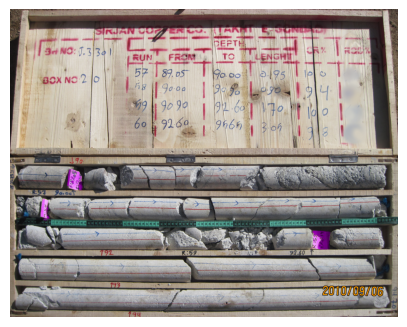

In [77]:
show_image(PIL.Image.open(os.path.join(test_folder,'M3-BH3301-20.jpg')))

In [78]:
out_df.head(5)

,RunId,SUM+10,lenght,RQD,Prediction
0,M3-BH3301-21-1,1.034015,0.95,108.843720,5
2,M3-BH3301-20-1,0.129821,0.15,86.547174,4
3,M3-BH3301-20-2,0.000000,0.90,0.000000,1
4,M3-BH3301-20-3,1.308047,1.70,76.943957,4
5,M3-BH3301-20-4,0.298285,2.10,14.204025,1
